# EXPLORATORY ANALYSIS_1

1. Will be importing the data from the provided dataset:

In [1]:
import pandas as pd

raw_data = pd.read_csv("https://raw.githubusercontent.com/4GeeksAcademy/data-preprocessing-project-tutorial/main/AB_NYC_2019.csv")

print ("Raw Dataset:")
print ("\n", raw_data)




Raw Dataset:

              id                                               name   host_id  \
0          2539                 Clean & quiet apt home by the park      2787   
1          2595                              Skylit Midtown Castle      2845   
2          3647                THE VILLAGE OF HARLEM....NEW YORK !      4632   
3          3831                    Cozy Entire Floor of Brownstone      4869   
4          5022   Entire Apt: Spacious Studio/Loft by central park      7192   
...         ...                                                ...       ...   
48890  36484665    Charming one bedroom - newly renovated rowhouse   8232441   
48891  36485057      Affordable room in Bushwick/East Williamsburg   6570630   
48892  36485431            Sunny Studio at Historical Neighborhood  23492952   
48893  36485609               43rd St. Time Square-cozy single bed  30985759   
48894  36487245  Trendy duplex in the very heart of Hell's Kitchen  68119814   

           host_name nei

# 2. Getting all the relevant information about the dataset:

In [9]:
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48895 entries, 0 to 48894
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              48895 non-null  int64  
 1   name                            48879 non-null  object 
 2   host_id                         48895 non-null  int64  
 3   host_name                       48874 non-null  object 
 4   neighbourhood_group             48895 non-null  object 
 5   neighbourhood                   48895 non-null  object 
 6   latitude                        48895 non-null  float64
 7   longitude                       48895 non-null  float64
 8   room_type                       48895 non-null  object 
 9   price                           48895 non-null  int64  
 10  minimum_nights                  48895 non-null  int64  
 11  number_of_reviews               48895 non-null  int64  
 12  last_review                     

The first conclusions we can extract from this first approach are:

-  There are a total of 48895 rows, in this particular case **Houses** or **Properties**, and 16 columns, which will complete the ecessary info to do the EDA.
- The data has 10 numerical characteristics and 6 categorical characteristics.

This is a fearly complete dataset without many null or zeros in the set, which will allow us to develop a good in depth study.


**-> Eliminating duplicates and irrelevant information:**

In [10]:
raw_data.drop("id", axis = 1).duplicated().sum()

np.int64(0)

In this case, we did not find any duplicate values. In the case that we had found it, the next step would've been to apply the **drop_duplicates() function.**

Now will take a look to a wee sample of our raw dataset to assess which variables are valuable to keel and be analysed and which one can be discharged to clean the data:

In [11]:
import pandas as pd

raw_data = pd.read_csv("https://raw.githubusercontent.com/4GeeksAcademy/data-preprocessing-project-tutorial/main/AB_NYC_2019.csv")

raw_data.head(5)

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


To decide which columns to keep, we are considering:

- Relevance: Keep columns that are essential for the analysis goals (e.g., location, price, and availability).
- Diversity: Retain columns that add variety and depth (e.g., room type, neighborhood, reviews).
- Completeness: Discard columns with a high proportion of missing values. In our case, there are none.
- Non-redundancy: Remove columns with duplicate or similar data.

**Suggested columns to keep:** neighbourhood_group, neighbourhood, room_type, price, minimum_nights, number_of_reviews, reviews_per_month, calculated_host_listings_count, availability_365, long_lat_ratio.

**Columns that will be discharged:** id, name, host_id, host_name, last_review, latitude, longitude.

*(Great suggestion from Fer to combine lat & long in one variable -> lat_long_ratio)

In [12]:
cleaned_data = raw_data.drop(columns=['id','name', 'host_id', 'host_name', 'last_review'])

# Great suggestion from Fer to combine lat & long in one variable -> lat_long_ratio:
cleaned_data['long_lat_ratio'] = cleaned_data['latitude'] - cleaned_data['longitude']

#cleaned_data = cleaned_data.drop(columns=['latitude', 'longitude'])

# Calculating the average price per neighbourhood_group:
cleaned_data['avg_price_neighbourhood_group'] = cleaned_data.groupby('neighbourhood_group')['price'].transform('mean')

# Calculating the average price per room_type:
cleaned_data['avg_price_room_type'] = cleaned_data.groupby('room_type')['price'].transform('mean')

# Display the first 5 rows to verify
cleaned_data.head(5)

,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,long_lat_ratio,avg_price_neighbourhood_group,avg_price_room_type
0,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,0.21,6,365,114.61986,124.383207,89.780973
1,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,0.38,2,355,114.73739,196.875814,211.794246
2,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,1,365,114.75092,196.875814,89.780973
3,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,4.64,1,194,114.64490,124.383207,211.794246
4,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,0.10,1,0,114.74250,196.875814,211.794246


This way, **raw_data** remains unchanged, and **cleaned_data** stores our filtered dataset.

**-> Definition of calculated_host_listings_count**: Number of airbnbs the same host have listed on airbnb website.


# Step 3: Analysis of univariate variables

Now will preform a column-by-column analysis of the DataFrame.
To do this, we will segregate whether our variables are categorical or numerical, as the body of the analysis and the conclusions that can be drawn will be different:

**Categorical variables:** neighbourhood_group, neighbourhood, room_type.

**Numerical variables:** price, minimum_nights, number_of_reviews, reviews_per_month, calculated_host_listings_count, long_lat_ratio, avg_price_neighbourhood_group, avg_price_room_type.

Review of  categorical variables:

In [ ]:
cleaned_data.neighbourhood_group.value_counts()

neighbourhood_group
Manhattan        21661
Brooklyn         20104
Queens            5666
Bronx             1091
Staten Island      373
Name: count, dtype: int64

In [8]:
cleaned_data.neighbourhood.value_counts()

neighbourhood
Williamsburg          3920
Bedford-Stuyvesant    3714
Harlem                2658
Bushwick              2465
Upper West Side       1971
                      ... 
Richmondtown             1
Fort Wadsworth           1
New Dorp                 1
Rossville                1
Willowbrook              1
Name: count, Length: 221, dtype: int64

In [9]:
cleaned_data.room_type.value_counts()

room_type
Entire home/apt    25409
Private room       22326
Shared room         1160
Name: count, dtype: int64

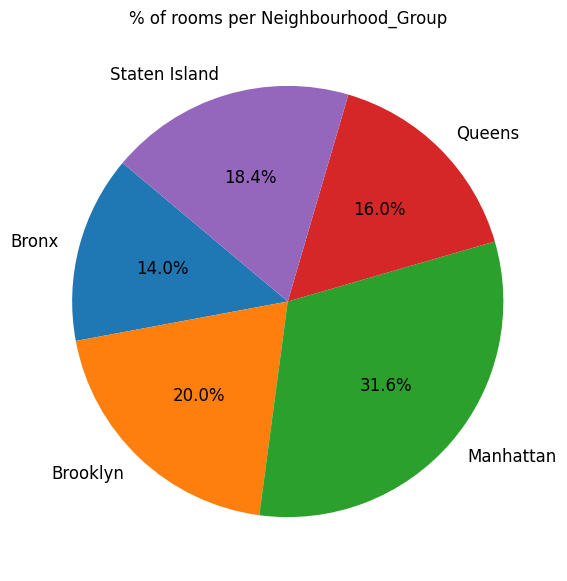

In [10]:
import matplotlib.pyplot as plt
import seaborn as sns

# Circular graph (pie chart)
plt.figure(figsize=(10, 7))
group_avg_prices = cleaned_data.groupby('neighbourhood_group')['avg_price_neighbourhood_group'].mean()
plt.pie(group_avg_prices, labels=group_avg_prices.index, autopct='%1.1f%%', startangle=140, textprops={'fontsize': 12})
plt.title('% of rooms per Neighbourhood_Group')
plt.show()

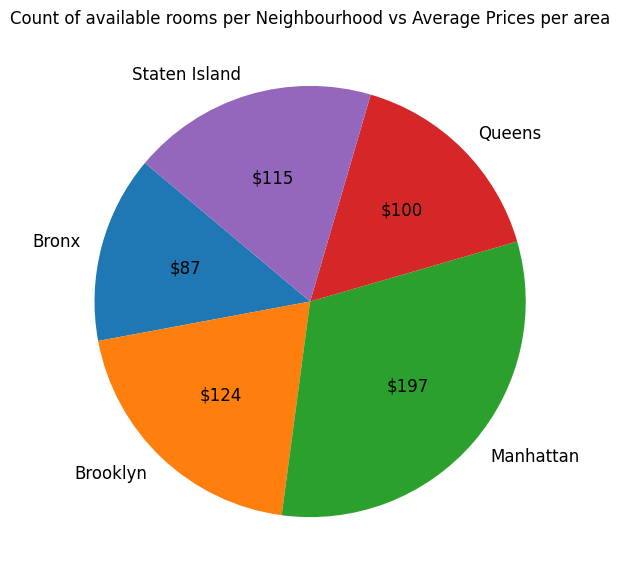

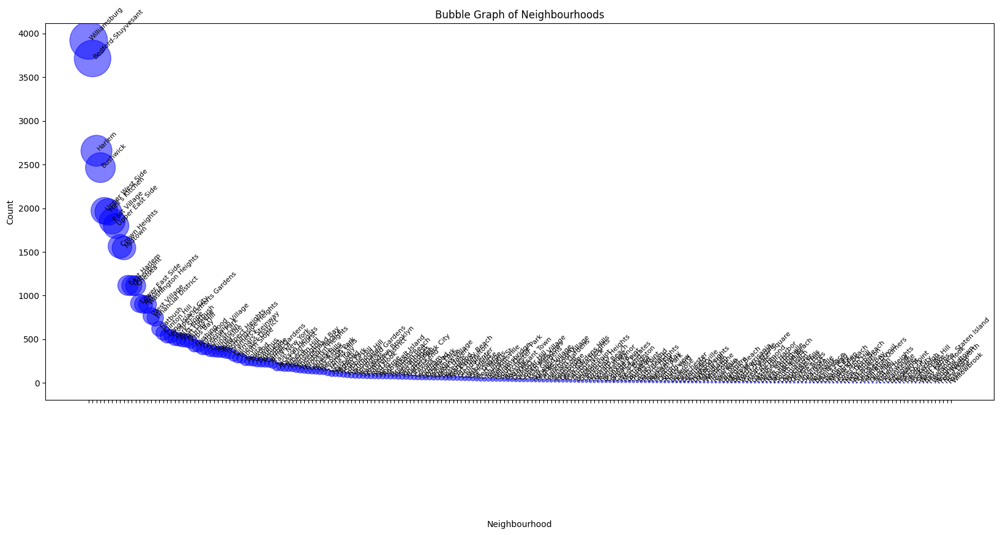

/tmp/ipykernel_1250/1851676530.py:28: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=cleaned_data, x="calculated_host_listings_count", palette='pastel')


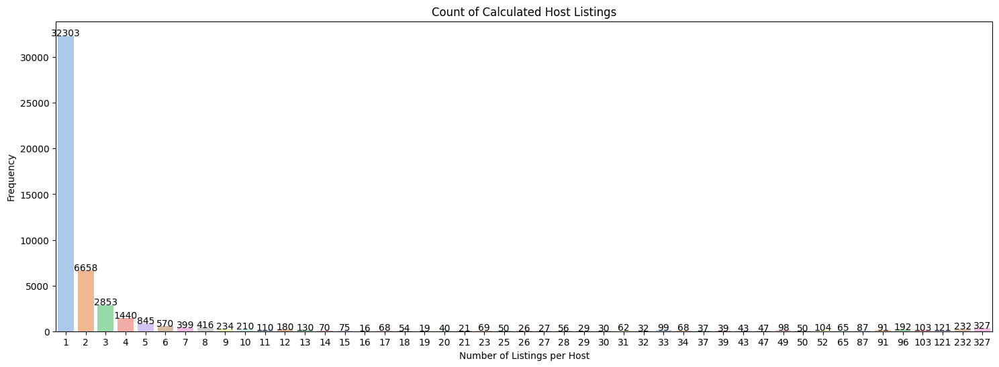

In [11]:
import matplotlib.pyplot as plt
import seaborn as sns

# 1 Pie chart with average price labels:
plt.figure(figsize=(10, 7))
group_avg_prices = cleaned_data.groupby('neighbourhood_group')['avg_price_neighbourhood_group'].mean()
wedges, texts, autotexts = plt.pie(group_avg_prices, labels=group_avg_prices.index, autopct=lambda p: f'${(p/100) * group_avg_prices.sum():.0f}', startangle=140, textprops={'fontsize': 12})
plt.title('Count of available rooms per Neighbourhood vs Average Prices per area')
plt.show()

# 2 Bubble graph of neighbourhood count:
plt.figure(figsize=(20, 8))
group_counts = cleaned_data['neighbourhood'].value_counts()
plt.scatter(group_counts.index, group_counts.values, s=group_counts.values * 0.5, alpha=0.5, c='blue')

for i, txt in enumerate(group_counts.index):
    plt.annotate(txt, (group_counts.index[i], group_counts.values[i]), fontsize=8, rotation=45, color='black')

plt.xticks(rotation=90, color='white')

plt.title('Bubble Graph of Neighbourhoods')
plt.xlabel('Neighbourhood')
plt.ylabel('Count')
plt.show()

# 3. 
plt.figure(figsize=(18, 6))
sns.countplot(data=cleaned_data, x="calculated_host_listings_count", palette='pastel')
plt.title('Count of Calculated Host Listings')
plt.xlabel('Number of Listings per Host')
plt.ylabel('Frequency')

# Add counts as labels on each bar
for p in plt.gca().patches:
    height = p.get_height()
    if height > 0:
        plt.text(p.get_x() + p.get_width() / 2., height + 1, int(height), ha='center')

plt.show()

In [12]:
import folium

# Create a folium map centered around Manhattan
m = folium.Map(location=[40.7831, -73.9712], zoom_start=12)

# Add markers for each room (latitude and longitude)
for index, row in cleaned_data.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=0.5,  # Size of the dot
        color='blue',
        fill=True,
        fill_opacity=0.4
    ).add_to(m)

# Displaying the map
m

**Observations:**
- **52%** of all the available rooms/flats are located in Manhattan and Brooklyng.
- These two locations are also the most expensive ones: The prices in Manhattan and Brooklyn are **3,2 times more expensive** in average than in Bronx, Queens & Staten Island.
- Also, can be seen that 85% of all the owners has only 1, 2 or 3 rooms / flats in rent.
- The districts with more properties available would be: Williamsburg, Bedford-Stuyvesant, Harlem, Bushwick.


Review of the numerical variables:

Price, minimum_nights, number_of_reviews, reviews_per_month, calculated_host_listings_count, long_lat_ratio, avg_price_neighbourhood_group, avg_price_room_type.

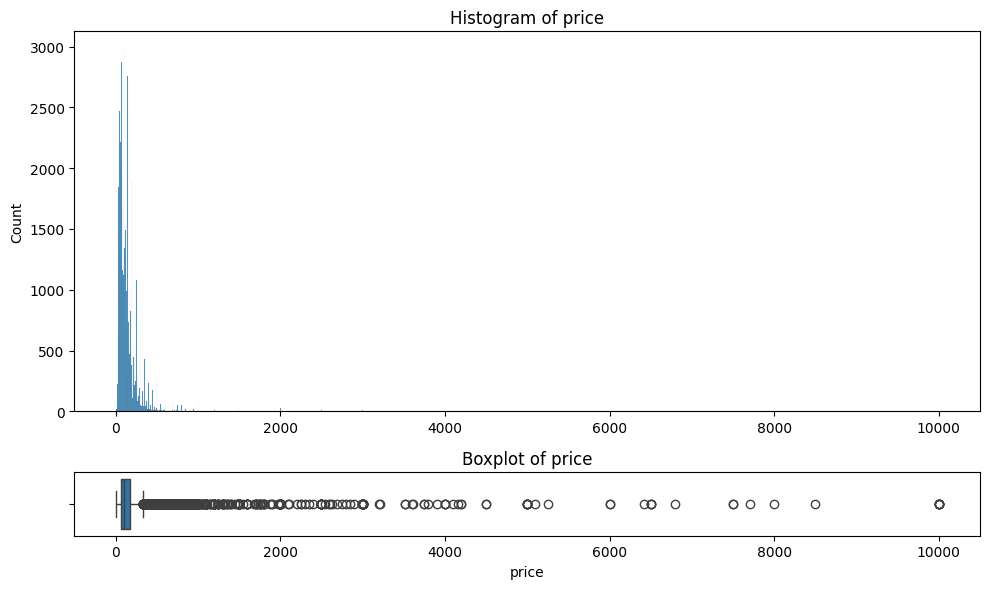

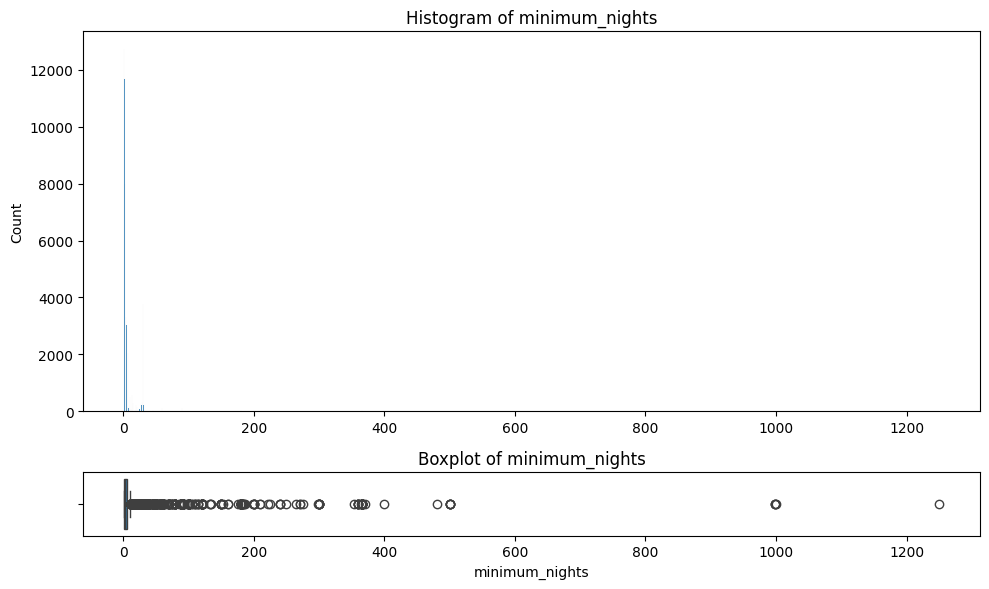

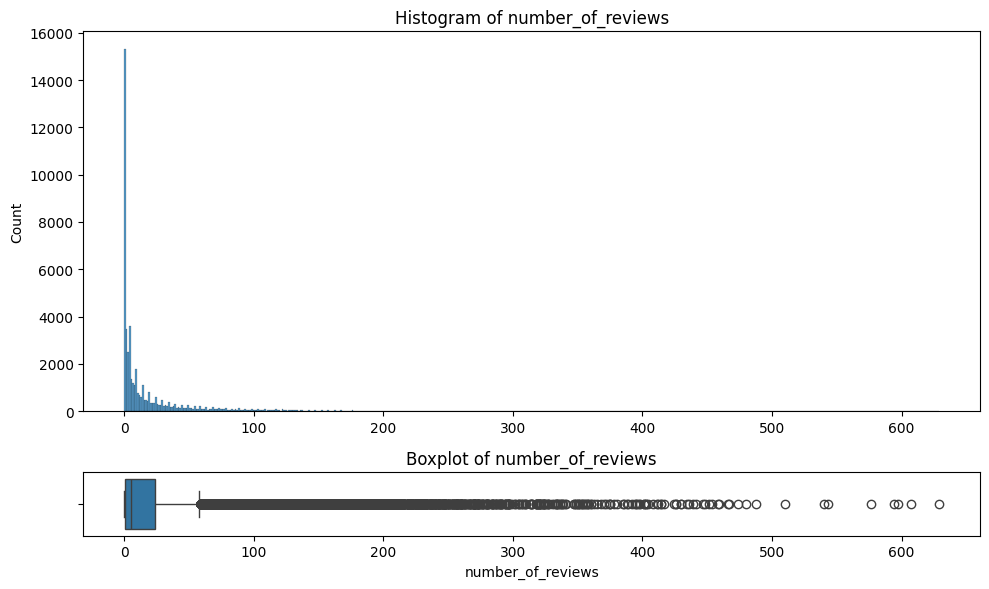

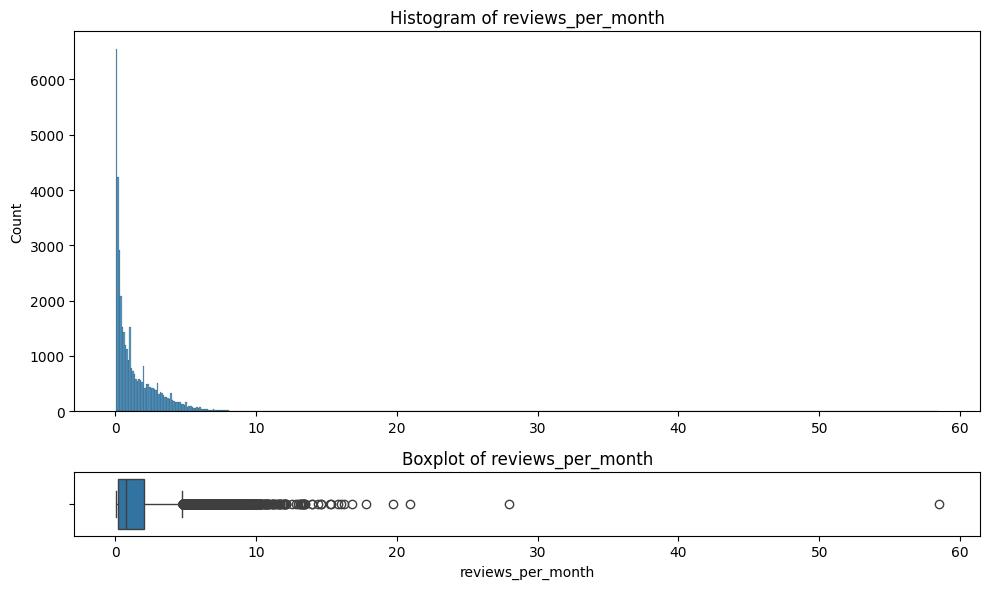

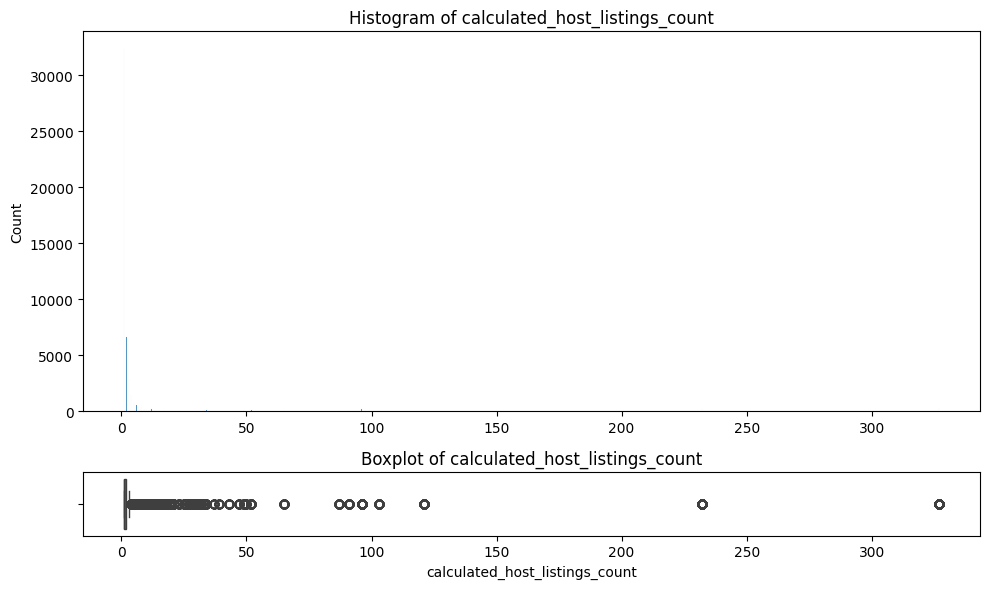

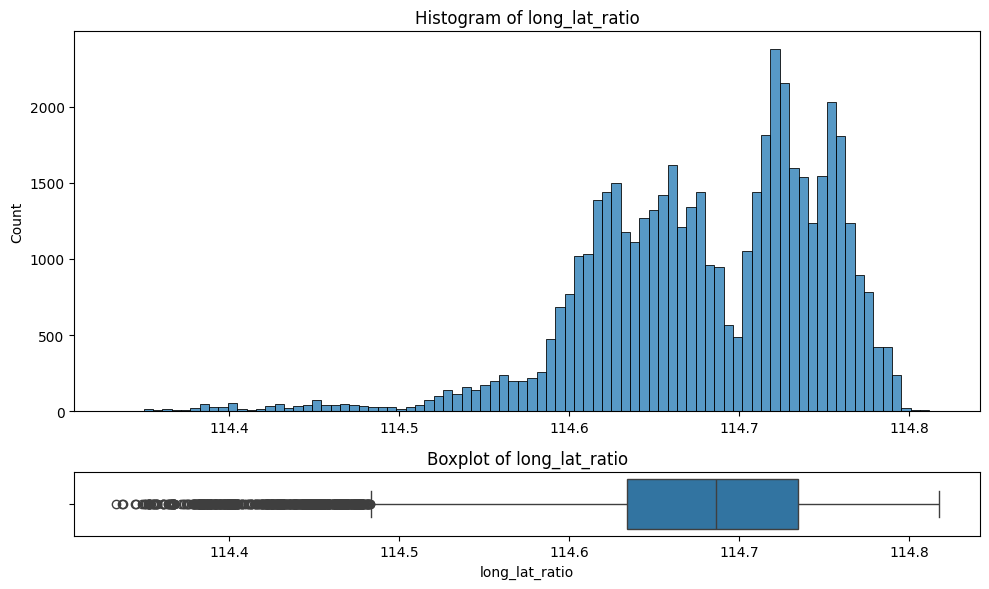

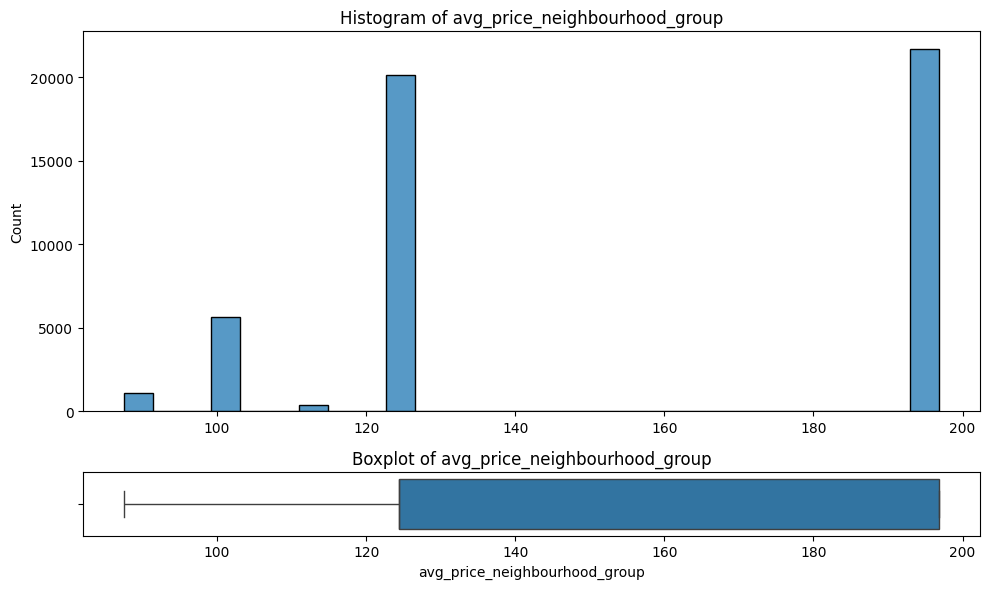

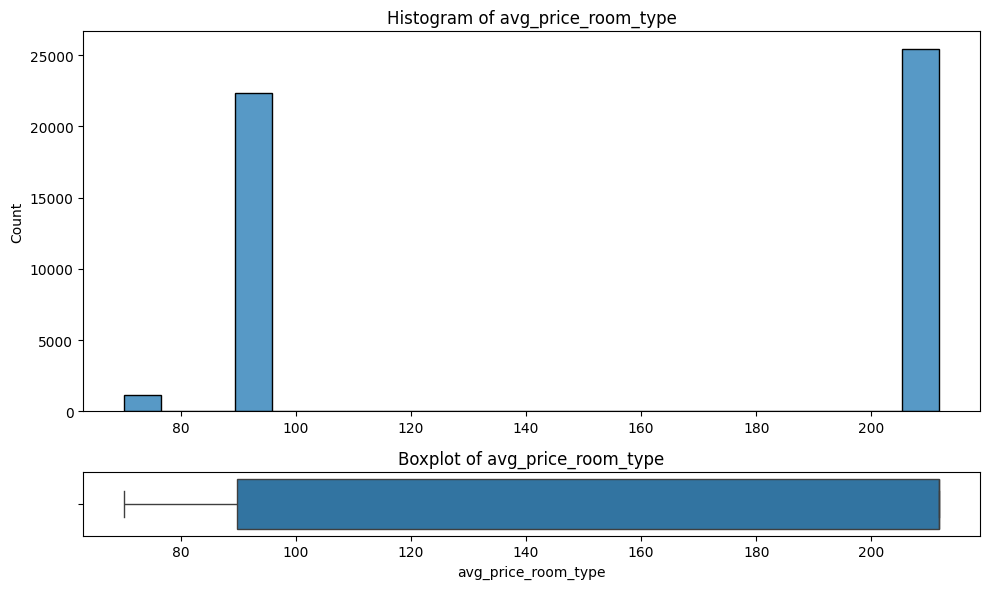

In [13]:
import matplotlib.pyplot as plt
import seaborn as sns

num_vars = ["price", "minimum_nights", "number_of_reviews", "reviews_per_month", 
            "calculated_host_listings_count", "long_lat_ratio", 
            "avg_price_neighbourhood_group", "avg_price_room_type"]

# Loop through each variable and create a plot
for var in num_vars:
    fig, axes = plt.subplots(2, 1, figsize=(10, 6), gridspec_kw={'height_ratios': [6, 1]})
    
    # Plot histogram
    sns.histplot(ax=axes[0], data=cleaned_data, x=var).set(xlabel=None)
    axes[0].set_title(f'Histogram of {var}')
    
    # Plot boxplot
    sns.boxplot(ax=axes[1], data=cleaned_data, x=var)
    axes[1].set_title(f'Boxplot of {var}')
    
    plt.tight_layout()
    plt.show()

Conclusions:

In general terms, there are many variables with lots or ouliers values. But it is interesting that the analysis of the standard distribution **for prices gives that anithing above 311 dollars is considered an outlier value.**

# 4. Multivariate Analysis

After analysing the characteristics one by one, now will need to analise them in relationship to the predictor variable. In dthis case PRICE.

**Numerical variables:** price, minimum_nights, number_of_reviews, reviews_per_month, calculated_host_listings_count, long_lat_ratio, avg_price_neighbourhood_group, avg_price_room_type.

**price vs minimum_night:**  

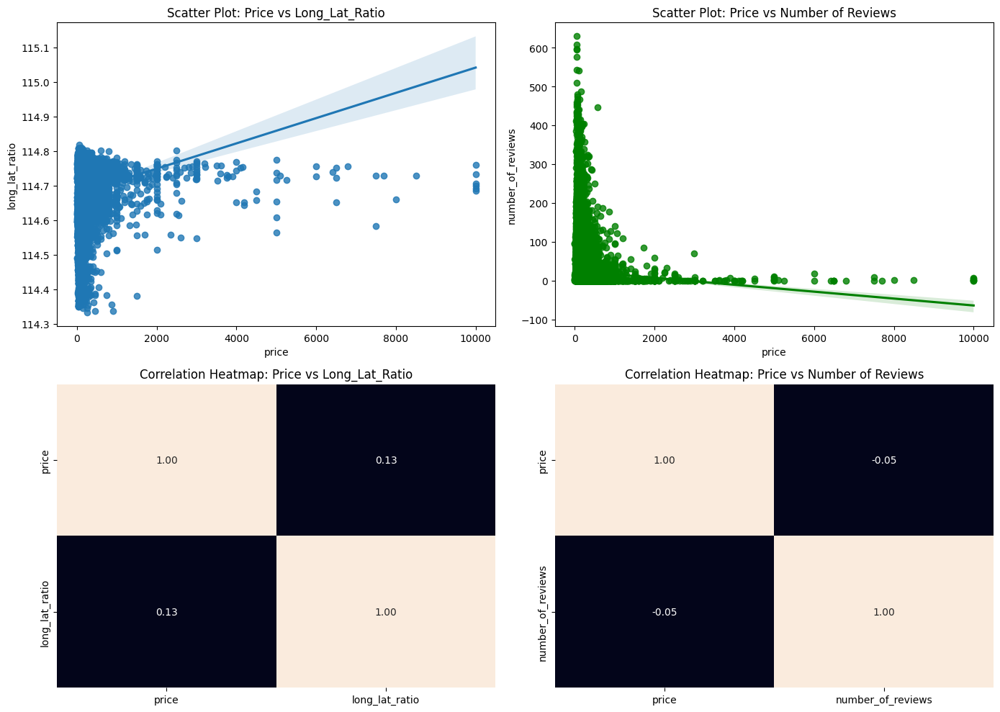

In [14]:
fig, axis = plt.subplots(2, 2, figsize=(14, 10))

# Scatter plot with regression for price vs long_lat_ratio
sns.regplot(ax=axis[0, 0], data=cleaned_data, x="price", y="long_lat_ratio")
axis[0, 0].set_title('Scatter Plot: Price vs Long_Lat_Ratio')

# Heatmap for correlation between price and long_lat_ratio
sns.heatmap(cleaned_data[["price", "long_lat_ratio"]].corr(), annot=True, fmt=".2f", ax=axis[1, 0], cbar=False)
axis[1, 0].set_title('Correlation Heatmap: Price vs Long_Lat_Ratio')

# Scatter plot with regression for price vs number_of_reviews
sns.regplot(ax=axis[0, 1], data=cleaned_data, x="price", y="number_of_reviews", color="green")
axis[0, 1].set_title('Scatter Plot: Price vs Number of Reviews')

# Heatmap for correlation between price and number_of_reviews
sns.heatmap(cleaned_data[["price", "number_of_reviews"]].corr(), annot=True, fmt=".2f", ax=axis[1, 1], cbar=False)
axis[1, 1].set_title('Correlation Heatmap: Price vs Number of Reviews')

# Adjust layout
plt.tight_layout()

# Display the plots
plt.show()

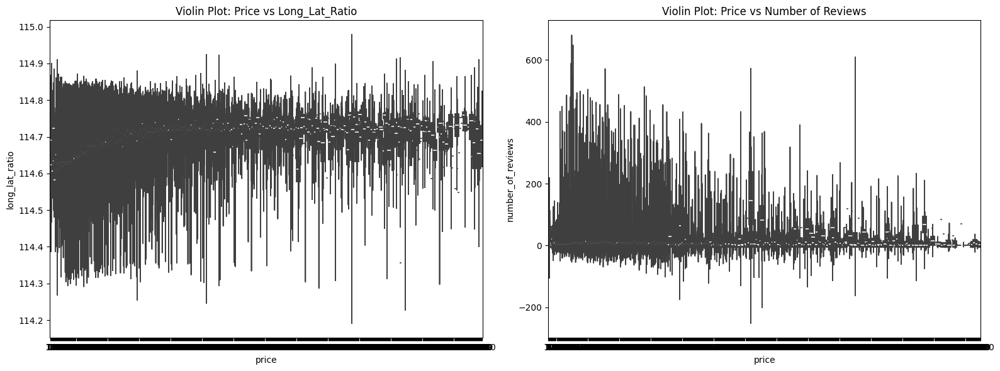

In [15]:
import matplotlib.pyplot as plt
import seaborn as sns

fig, axis = plt.subplots(1, 2, figsize=(16, 6))

# Violin plot for price vs long_lat_ratio
sns.violinplot(ax=axis[0], x='price', y='long_lat_ratio', data=cleaned_data)
axis[0].set_title('Violin Plot: Price vs Long_Lat_Ratio')

# Violin plot for price vs number_of_reviews
sns.violinplot(ax=axis[1], x='price', y='number_of_reviews', data=cleaned_data)
axis[1].set_title('Violin Plot: Price vs Number of Reviews')

# Adjust the layout
plt.tight_layout()

# Display the plots
plt.show()

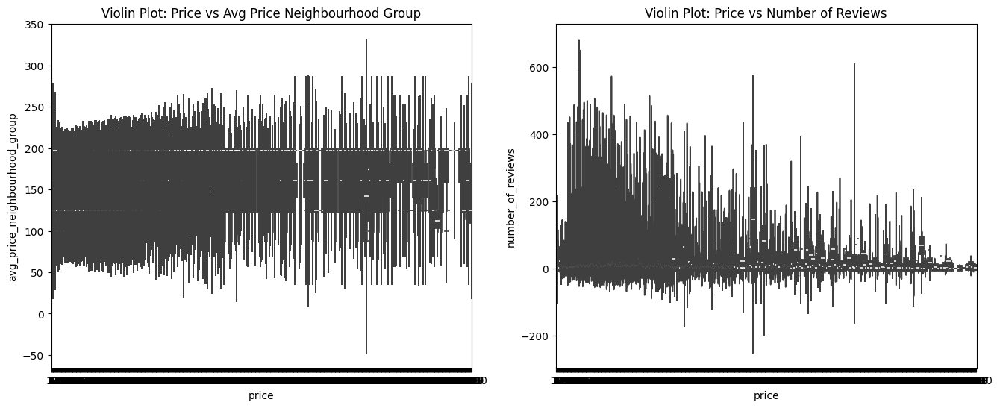

In [16]:
import matplotlib.pyplot as plt
import seaborn as sns

fig, axis = plt.subplots(1, 2, figsize=(16, 6))

# Violin plot for price vs avg_price_neighbourhood_group
sns.violinplot(ax=axis[0], x='price', y='avg_price_neighbourhood_group', data=cleaned_data)
axis[0].set_title('Violin Plot: Price vs Avg Price Neighbourhood Group')

# Violin plot for price vs number_of_reviews (keeping it for comparison)
sns.violinplot(ax=axis[1], x='price', y='number_of_reviews', data=cleaned_data)
axis[1].set_title('Violin Plot: Price vs Number of Reviews')

# Display the plots
plt.show()

- Widening if the number of reviews for the lower prices range.
- Most of the affordable rooms/flats are in a very defined area based on the long_lat_ratio values.

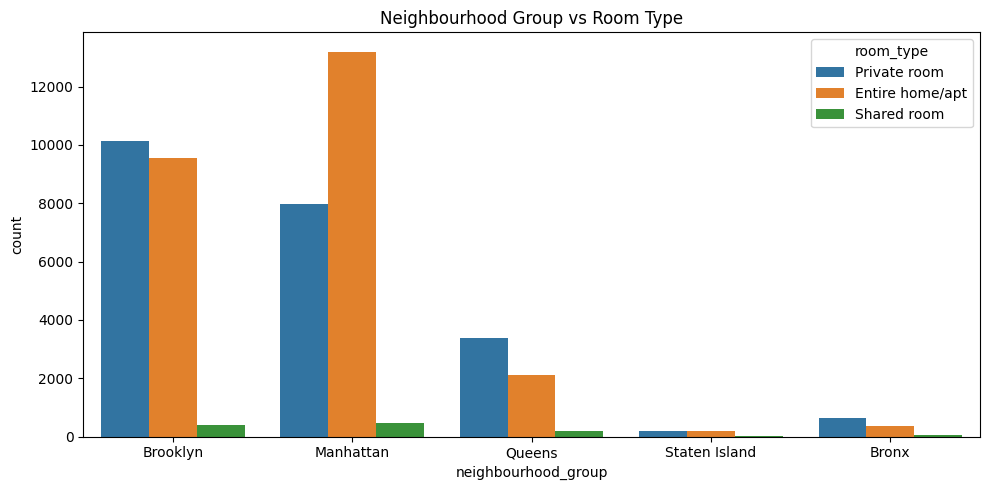

In [17]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize = (10, 5))

# Create the countplot for neighbourhood_group vs room_type:
sns.countplot(data = cleaned_data, x = "neighbourhood_group", hue = "room_type").set(title="Neighbourhood Group vs Room Type")

plt.tight_layout()
plt.show()

In [14]:
# Transform categorical variables into numeric using factorize:

cleaned_data["neighbourhood_group_n"] = pd.factorize(cleaned_data["neighbourhood_group"])[0]
cleaned_data["room_type_n"] = pd.factorize(cleaned_data["room_type"])[0]

# Display the first few rows to check the transformation
print(cleaned_data[["neighbourhood_group", "neighbourhood_group_n", "room_type", "room_type_n"]].head())

  neighbourhood_group  neighbourhood_group_n        room_type  room_type_n
0            Brooklyn                      0     Private room            0
1           Manhattan                      1  Entire home/apt            1
2           Manhattan                      1     Private room            0
3            Brooklyn                      0  Entire home/apt            1
4           Manhattan                      1  Entire home/apt            1


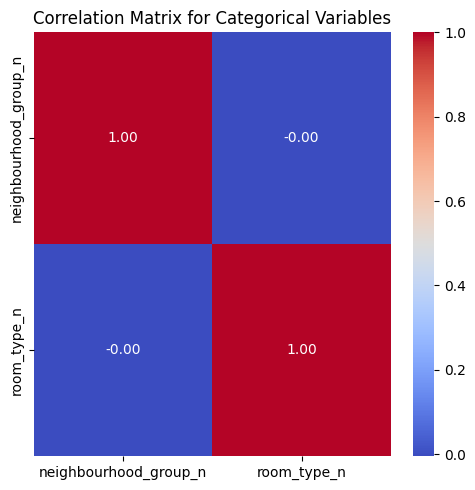

In [11]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a heatmap for the correlation matrix of the converted numerical categorical variables
fig, axis = plt.subplots(figsize=(5, 5))

# Plot the correlation matrix
sns.heatmap(
    cleaned_data[["neighbourhood_group_n", "room_type_n"]].corr(), 
    annot=True, 
    fmt=".2f", 
    cmap="coolwarm"  # Optional: Change the color scheme for better visualization
)

plt.title("Correlation Matrix for Categorical Variables")
plt.tight_layout()

plt.show()

- No evidences of any relationship in between the neighbourhood group and the number of rooms.

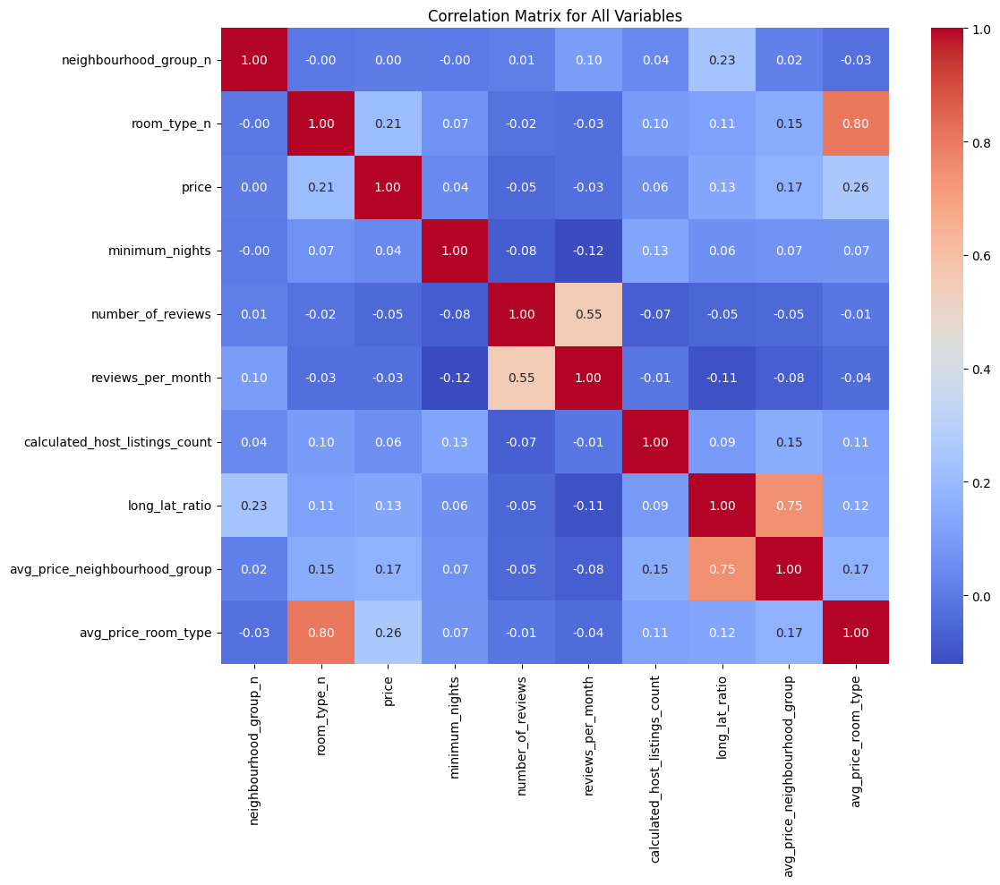

In [12]:
import matplotlib.pyplot as plt
import seaborn as sns

# List of variables for correlation analysis
variables = [
    "neighbourhood_group_n", "room_type_n", "price", "minimum_nights", 
    "number_of_reviews", "reviews_per_month", "calculated_host_listings_count", 
    "long_lat_ratio", "avg_price_neighbourhood_group", "avg_price_room_type"
]

# Create a heatmap for the correlation matrix of the specified variables
fig, axis = plt.subplots(figsize=(12, 10))  # Adjust figsize for better readability

# Plot the correlation matrix
sns.heatmap(
    cleaned_data[variables].corr(), 
    annot=True, 
    fmt=".2f", 
    cmap="coolwarm"
)

plt.title("Correlation Matrix for All Variables")
plt.tight_layout()

plt.show()

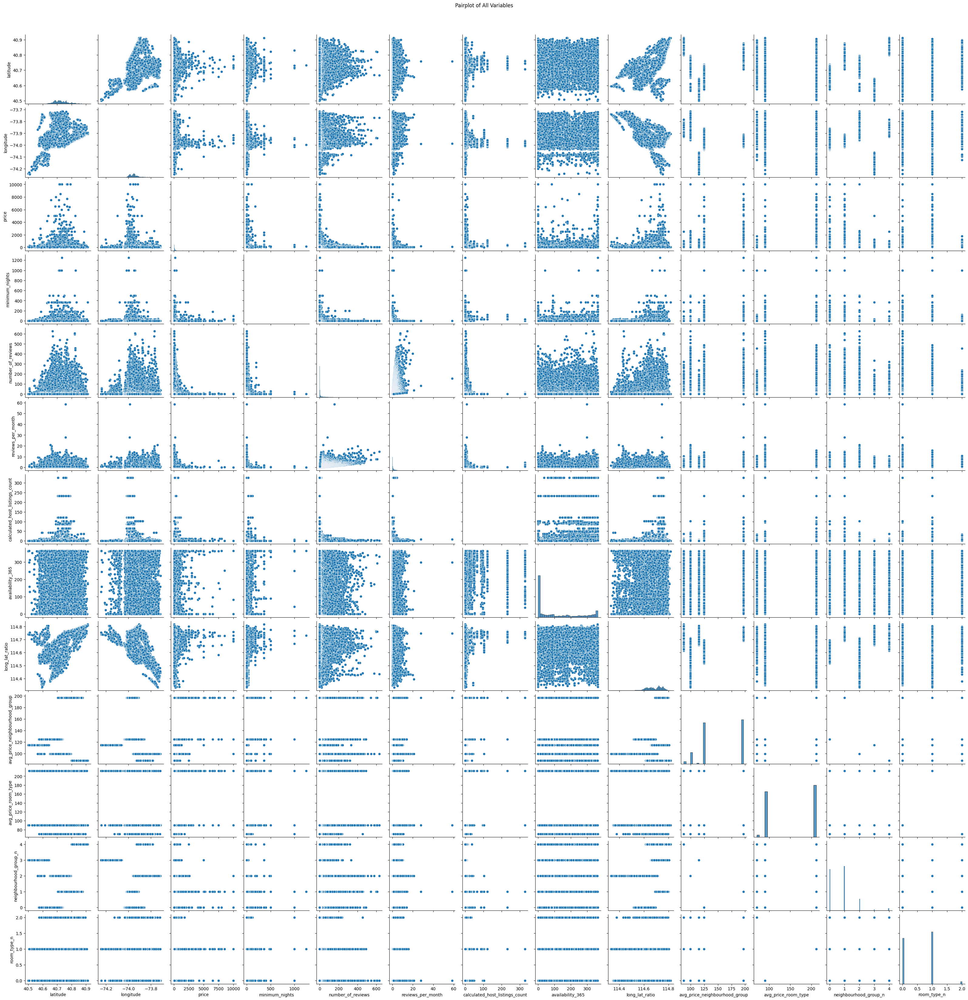

In [21]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create a pairplot for the cleaned_data DataFrame
sns.pairplot(data=cleaned_data)

plt.suptitle("Pairplot of All Variables", y=1.02)  # Adding a title with adjusted vertical spacing
plt.show()

# Conclusions:

From the correlation analysis we can extract some observations and conclusions.
High "R or r" correlation factor describe the relationship in between variables and how close one follows the other.

**Price Relationships:**

If the correlation is positive and significant, it means higher prices in one area or room type tend to be accompanied by higher prices overall.

**Minimum Nights:**

Minimum_nights has lower or insignificant correlations with other variables. This could imply that the minimum number of nights required for a stay does not have a strong direct relationship with the other variables, neither price per night.

**Number of Reviews and Reviews per Month:**

These two metrics might be correlated, which indicates that properties with more reviews generally receive more frequent reviews. This could mean that popular or frequently booked properties are more actively reviewed.

**Calculated Host Listings Count (hiden variable):**

If this variable has notable correlations with price or room_type, it could imply that hosts managing more listings may charge different rates or prefer certain room types.

**Room Type and Neighborhood Influence:**

The correlation between room_type_n and other variables can show how room types might impact pricing or reviews. Similarly, neighbourhood_group_n could reveal which areas are more influential on factors like price or popularity.
In simple terms, the analysis helps us see how these features are related.

# ---------------------------------------------------------------------------------------------------

# 4. Feature engineering

-> This involves a variety of techniques, such as normalization, data transformation, etc...

The goal is to improve the accuracy of the model and/or reduce the complexity of the model, and then making it easier to interpret.

**Outliers Analysis:**

In [15]:
cleaned_data.describe()


,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,long_lat_ratio,avg_price_neighbourhood_group,avg_price_room_type,neighbourhood_group_n,room_type_n
count,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,38843.000000,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000
mean,40.728949,-73.952170,152.720687,7.029962,23.274466,1.373221,7.143982,112.781327,114.681118,152.720687,152.720687,0.786911,0.567113
std,0.054530,0.046157,240.154170,20.510550,44.550582,1.680442,32.952519,131.622289,0.068390,40.346334,61.515886,0.844386,0.541249
min,40.499790,-74.244420,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000,114.333230,87.496792,70.127586,0.000000,0.000000
25%,40.690100,-73.983070,69.000000,1.000000,1.000000,0.190000,1.000000,0.000000,114.634030,124.383207,89.780973,0.000000,0.000000
50%,40.723070,-73.955680,106.000000,3.000000,5.000000,0.720000,1.000000,45.000000,114.686290,124.383207,211.794246,1.000000,1.000000
75%,40.763115,-73.936275,175.000000,5.000000,24.000000,2.020000,2.000000,227.000000,114.734610,196.875814,211.794246,1.000000,1.000000
max,40.913060,-73.712990,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000,114.817330,196.875814,211.794246,4.000000,2.000000


Although the data in the table above is giving us already good information, drawing box plots of the variables also gives us very powerful information about outliers that fall outside the confidence regions:

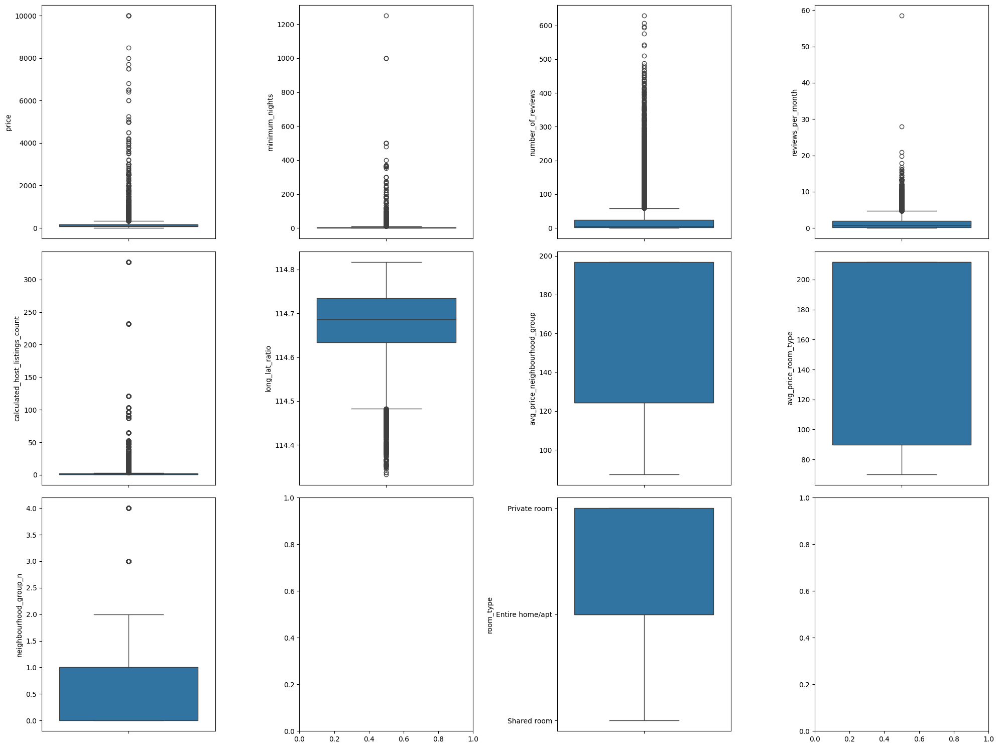

In [18]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create subplots to represent all variables in 'cleaned_data'
fig, axis = plt.subplots(3, 4, figsize=(20, 15))

# Replace 'total_data' with 'cleaned_data' and adjust variable names accordingly
sns.boxplot(ax=axis[0, 0], data=cleaned_data, y="price")
sns.boxplot(ax=axis[0, 1], data=cleaned_data, y="minimum_nights")
sns.boxplot(ax=axis[0, 2], data=cleaned_data, y="number_of_reviews")
sns.boxplot(ax=axis[0, 3], data=cleaned_data, y="reviews_per_month")

sns.boxplot(ax=axis[1, 0], data=cleaned_data, y="calculated_host_listings_count")
sns.boxplot(ax=axis[1, 1], data=cleaned_data, y="long_lat_ratio")
sns.boxplot(ax=axis[1, 2], data=cleaned_data, y="avg_price_neighbourhood_group")
sns.boxplot(ax=axis[1, 3], data=cleaned_data, y="avg_price_room_type")

# Categorical variables (assumed already converted to numerical)
sns.boxplot(ax=axis[2, 0], data=cleaned_data, y="neighbourhood_group_n")
sns.boxplot(ax=axis[2, 2], data=cleaned_data, y="room_type")

# Adjust layout for better visualization
plt.tight_layout()

# Display the plots
plt.show()

In [20]:
price_stats = cleaned_data["price"].describe()

price_stats

count    48895.000000
mean       152.720687
std        240.154170
min          0.000000
25%         69.000000
50%        106.000000
75%        175.000000
max      10000.000000
Name: price, dtype: float64

In [21]:
price_iqr = price_stats["75%"] - price_stats["25%"]
upper_limit = price_stats["75%"] + 1.5 * price_iqr
lower_limit = price_stats["25%"] - 1.5 * price_iqr

print(f"The upper and lower limits for finding outliers are {round(upper_limit, 2)} and {round(lower_limit, 2)}, with an interquartile range of {round(price_iqr, 2)}")

The upper and lower limits for finding outliers are 334.0 and -90.0, with an interquartile range of 106.0


Based on these results, we should eliminate the records of rooms or flats which amount exceeds $334. However, our criteria is very important here, and, according to the prices we saw in the box plot, the most extreme values are above $3000. Let's see how many values represent that extreme value of 334:

In [22]:
high_prices = cleaned_data[cleaned_data["price"] > 334]

Considering the dataframe "cleaned_data" has 48895 values, there's only 2972 values considered as outliers. Given this, will eliminate those:

In [23]:
high_prices.neighbourhood_group.value_counts()

neighbourhood_group
Manhattan        2155
Brooklyn          689
Queens             99
Bronx              21
Staten Island       8
Name: count, dtype: int64

As was expected, the area with most outliers is Manhattan, being the most central and populat of NY City. Given the proportion of outliers are low, will be eliminated from the dataset:

In [24]:
# Eliminating outliers from the "price" column:
total_data = cleaned_data[(cleaned_data["price"] >= lower_limit) & (cleaned_data["price"] <= upper_limit)]

print("Number of rows after outlier removal:", cleaned_data.shape[0])

Number of rows after outlier removal: 48895


**Missing values:**

In [6]:
cleaned_data.isnull().sum().sort_values(ascending=False)

reviews_per_month                 10052
neighbourhood_group                   0
latitude                              0
longitude                             0
room_type                             0
neighbourhood                         0
price                                 0
minimum_nights                        0
number_of_reviews                     0
calculated_host_listings_count        0
availability_365                      0
long_lat_ratio                        0
avg_price_neighbourhood_group         0
avg_price_room_type                   0
dtype: int64

In [25]:
cleaned_data["reviews_per_month"].fillna(cleaned_data["reviews_per_month"].median(), inplace=True)


/tmp/ipykernel_1243/105572133.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  cleaned_data["reviews_per_month"].fillna(cleaned_data["reviews_per_month"].median(), inplace=True)


**Feature scaling**

This is a very important step to change the range of data values so that they can be compared to each other.


price, minimum_nights, number_of_reviews, reviews_per_month, calculated_host_listings_count, long_lat_ratio, avg_price_neighbourhood_group, avg_price_room_type.

In [27]:
from sklearn.preprocessing import MinMaxScaler
import pandas as pd

num_variables = ["price, minimum_nights, number_of_reviews, reviews_per_month, calculated_host_listings_count, long_lat_ratio, avg_price_neighbourhood_group, avg_price_room_type, neighbourhood_group_n"]
scaler = MinMaxScaler()
scal_features = scaler.fit_transform(cleaned_data[num_variables])
df_scal = pd.DataFrame(scal_features, index = cleaned_data.index, columns = num_variables)
df_scal["price"] = cleaned_data["price"]
df_scal.head()

KeyError: "None of [Index(['price, minimum_nights, number_of_reviews, reviews_per_month, calculated_host_listings_count, long_lat_ratio, avg_price_neighbourhood_group, avg_price_room_type, neighbourhood_group_n'], dtype='object')] are in the [columns]"